# UMAPs Neurips samples, NK cells

In this notebook different markers to identify NK cell subpopulations are tested. Markers are collected from Pfefferle et al., paper from 2019. RNA and corresponding surface markers are shown when available. Protein expression levels within a cell are normalized using the centered-log ratio (CLR) transformation. UMAPs are generated using latent space representation of measured RNA and surface protein data. 

Reference: Pfefferle, A., Netskar, H., Ask, E. H., Lorenz, S., Goodridge, J. P., Sohlberg, E., Clancy, T., & Malmberg, K.-J. (2019). A Temporal Transcriptional Map of Human Natural Killer Cell Differentiation. BioRxiv, 630657. https://doi.org/10.1101/630657


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
#To find gene names

result = [i for i in adata_neurips.var_names if i.startswith('TC')]
print(result)

['TC2N', 'TCAF1', 'TCAF2', 'TCAIM', 'TCAP', 'TCEA1', 'TCEA2', 'TCEA3', 'TCEAL1', 'TCEAL2', 'TCEAL3', 'TCEAL4', 'TCEAL5', 'TCEAL7', 'TCEAL8', 'TCEAL9', 'TCEANC', 'TCEANC2', 'TCEB1', 'TCEB2', 'TCEB3', 'TCEB3-AS1', 'TCERG1', 'TCF12', 'TCF15', 'TCF19', 'TCF20', 'TCF23', 'TCF25', 'TCF3', 'TCF4', 'TCF4-AS2', 'TCF7', 'TCF7L1', 'TCF7L2', 'TCFL5', 'TCHH', 'TCHP', 'TCIRG1', 'TCL1A', 'TCL1B', 'TCL6', 'TCN2', 'TCOF1', 'TCP1', 'TCP10L', 'TCP11', 'TCP11L1', 'TCP11L2', 'TCTA', 'TCTE1', 'TCTE3', 'TCTEX1D1', 'TCTEX1D2', 'TCTEX1D4', 'TCTN1', 'TCTN2', 'TCTN3']


In [4]:
#Both NK cell types selected

neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [5]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [6]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [7]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

In [8]:
samples=adata_neurips.obs['POOL'].unique().tolist()

In [9]:
#selecting one sample from Neurips

eg=adata_neurips[adata_neurips.obs['POOL'] == "s4d1"]


In [10]:
eg

View of AnnData object with n_obs × n_vars = 4885 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [11]:
prot=eg.obsm['protein_expression_clr_neurips']

In [12]:
#some proteins and genes have same names, here _prot added after protein names
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CX3CR1': 'CX3CR1_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})


In [13]:
#adding protein information to obs

a = eg.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
eg.obs=adata_eg


In [14]:
#selecting NK cells, gd T cells and ILCs

sample_nk = eg[(eg.obs['cell_type'] == "NK") | (eg.obs['cell_type'] == "NK CD158e1+") | (eg.obs['cell_type'] == "ILC") | (eg.obs['cell_type'] == "gdT CD158b+")]   


In [15]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_neurips, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(adata_neurips)

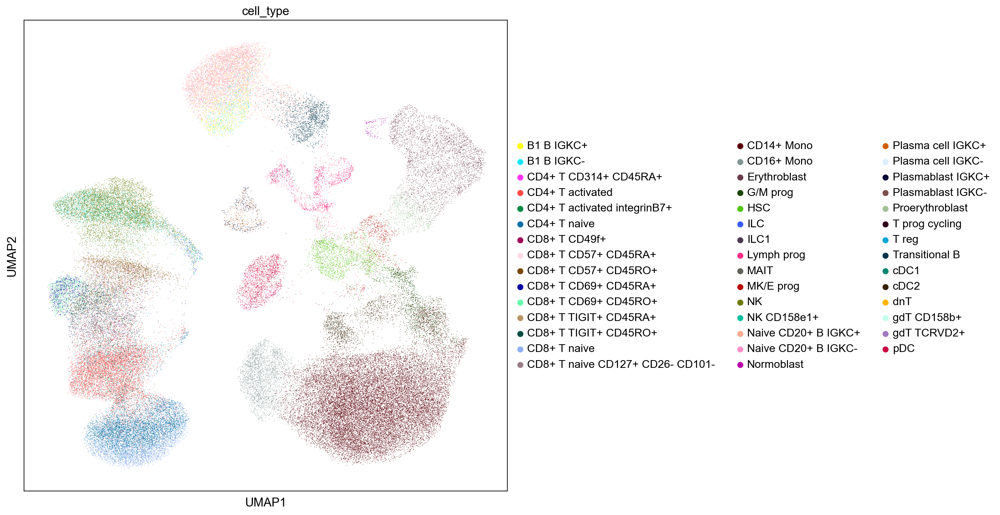

In [16]:
#Whole Neurips dataset plotted

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_neurips, color = ['cell_type'], color_map = 'viridis')

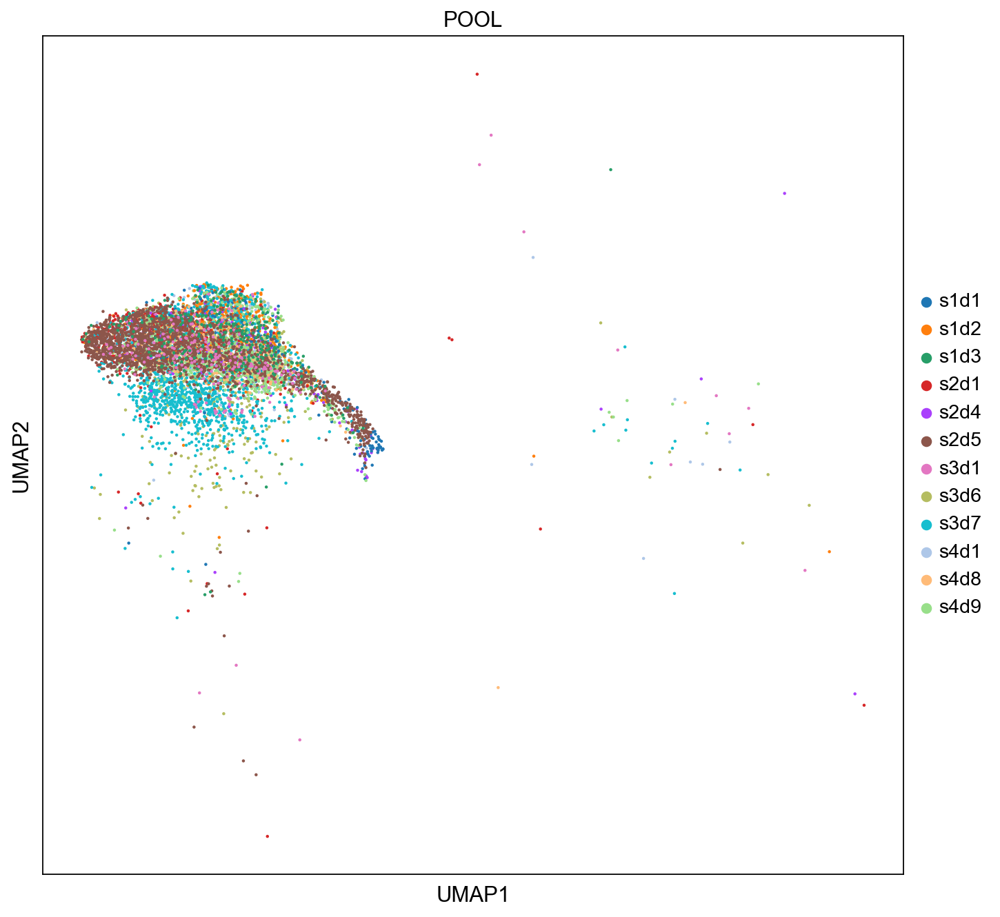

In [17]:
# NK cells from Neurips dataset, coloured by samples

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(neurips_nk, color = ['POOL'])

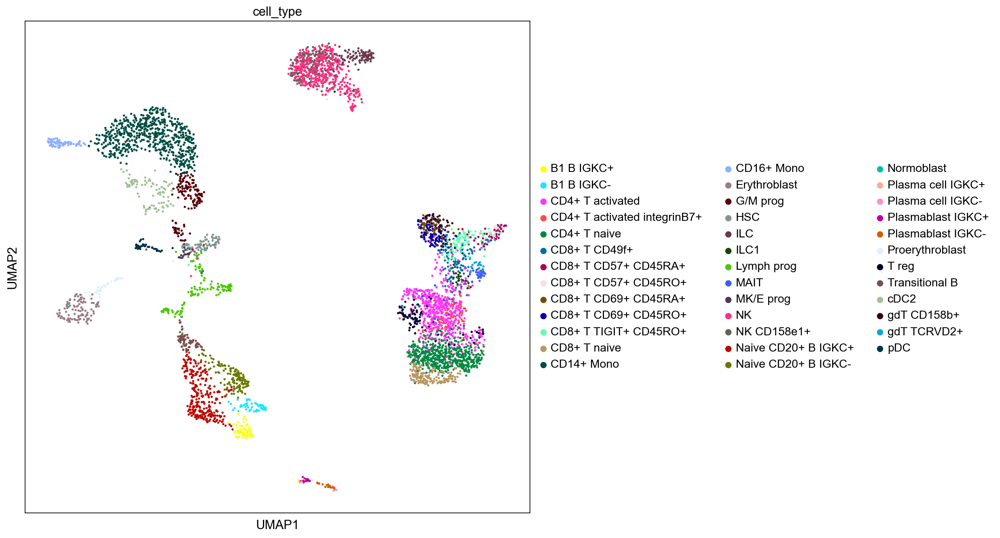

In [18]:
#Only selected sample

sc.set_figure_params(figsize=(10, 10))


sc.pl.umap(eg, color = ['cell_type'], color_map = 'viridis')

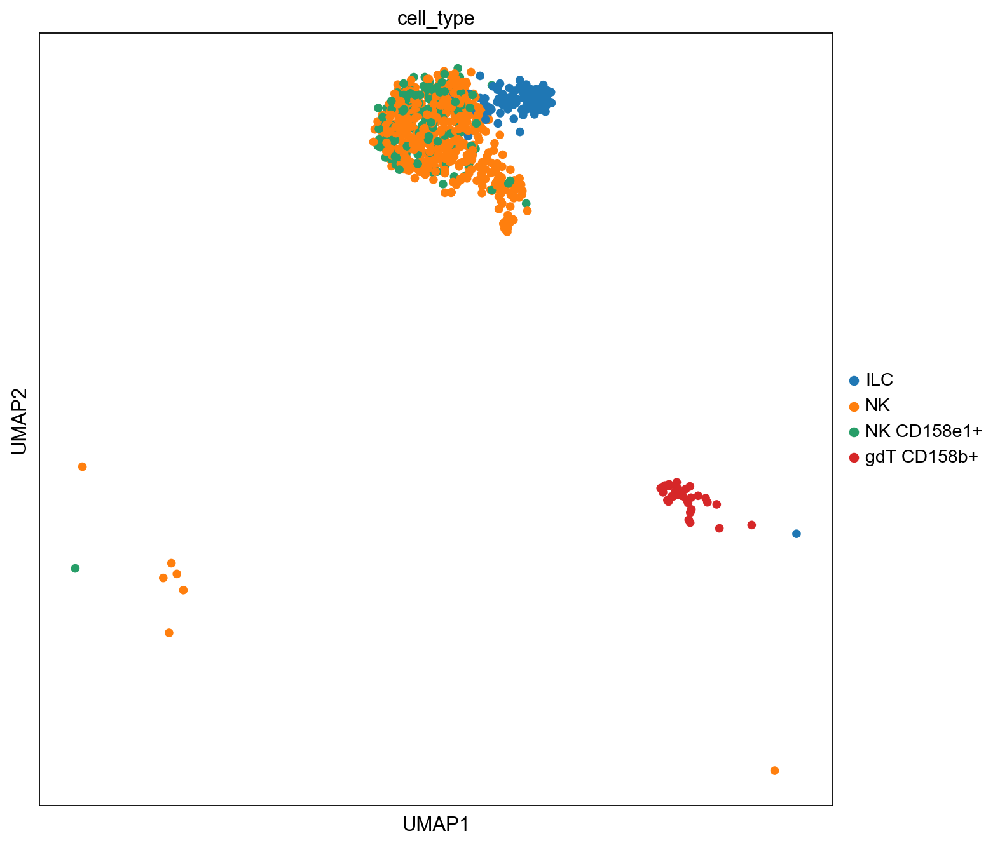

In [19]:
#NK, gd T cells and ILCs from selected sample

sc.pl.umap(sample_nk, color = ['cell_type'], color_map = 'viridis')

## Markers collected from Pfefferle et al. paper

- scRNA-seq performed on >26 000 PBMC, healthy donors
- Bulk RNA-seq: CD56bright, CD56dim NK cells, two CD56dim subsets: NKG2A+KIR− and NKG2A−KIR+9

From immature to the most mature (adaptive) NK cells (bulk RNA-seq):
- CD56 (NCAM1)+ (immature)
- NKG2A(CD94)+, KIR2DL3(CD158b)−, CD56dim (conventional)
- NKG2A/KLRC1(CD94)−, KIR2DL3(CD158b)+, CD56dim  (conventional)
- NKG2A/KLRC1, (CD94)−, KIR2DL3(CD158b)+, NKG2C(CD159c)+, CD56dim (adaptive)

Clustering analysis (5 clusters) by scRNA-seq: 
- Cluster 1: IFNG, OAS1, FGR, CDK6, CCR5 (CD195), SLC37A1, IL2RB(CD122), IL2RG(CD132), IL15RA(CD215), KLRD1(CD94), RUNX3 and IKZF2 (CD56bright, immature NK cells)
- Cluster 2:  XCL1, SELL(CD62L), CCR1(CD191), LEF1, IL7R(CD127), GZMK, LTB, CD27, CCR7(CD197), MYC, CAPG, KIT(CD117), IL23A and BACH2.
- Cluster 3: CCL3, CCL4, CCL5, RORA, GZMA, GZMB, GZMH, GZMM,FCGR3A(CD16), TIGIT (TIGIT), NFKBIA, CX3CR1, PRDM1, ZEB2, TFEB, MICB, CD38, LAIR2, GNAQ, RETSAT, CCDC41, BTRC and NARS2 (CD56dim subpopulation)
- Cluster 4-5: The comparison between cluster 4 and 5 is represents the transition from conventional to adaptive NK cells and was characterized by a general loss of gene expression. ALKBH2 high in cluster 4. 


- The largest difference between clusters 2 and 3 (transition from CD56bright to CD56dim. 
- Cluster 3 represents a slightly more activated cell state within the conventional CD56dim NK cell compartment with higher expression of cytokine receptors, CD38, SIGLEC7, KLRB1, and TBX21, rather than being a unique differentiation stage


Transition from CD56bright to CD56dim 
- CD96, TIGIT, PVR, CD226, CD161 

Two CD56bright populations found in pseudotime analysis, population 1 high:
- KLRB1 (CD161) KLRD1 (CD94), NCAM1 (CD56), CD7, IL15RA (CD215), IL2RB (CD122), IL2RG (CD132), RUNX3 and IKZF2 (Ikaros) expression

---------------------------


In [18]:
#Protein

nk_immature_pfef = ['CD56']
nk56dim_pfef = ['CD158b', 'CD57'] #adaptive NK cells

# corresponding RNA

nk_immature_pfef_rna = ['NCAM1']
nk56dim_pfef_rna = ['KIR2DL3', 'B3GAT1']

# nk_adaptive =['CD158b', 'CD159c, CD57'] CD159c not used in Neurips, so this is same as previous

nk_transition= ['TIGIT_prot', 'CD155', 'CD226', 'CD161'] #transition from CD56brigth to CD56dim


c1_pfef = ['CD195', 'CD122', 'CD94']
c2_pfef = ['CD62L', 'CD127', 'CD27_prot', 'TIGIT_prot']
c3_pfef = ['CD16', 'CD38_prot']


pseudotime= ['CD161', 'CD94', 'CD56', 'CD5', 'CD7', 'CD122']

#RNA

c1_pfef_rna = ['CCR5', 'IL2RB', 'KLRD1']
c2_pfef_rna = ['SELL', 'IL7R', 'CD27', 'TIGIT']
c3_pfef_rna = ['FCGR3A', 'CD38']

#Transition from CD56bright to CD56dim

cd56bright_tf_pfef= ['TFC1', 'MYC']
cd56dim_tf_pfef = ['PRDM1', 'ZEB2', 'MAF']
nk_transition_rna= ['TIGIT', 'PVR', 'CD226', 'KLRB1']
pseudotime_rna= ['KLRB1', 'KLRD1', 'NCAM1', 'CD5', 'CD7', 'IL2RB']

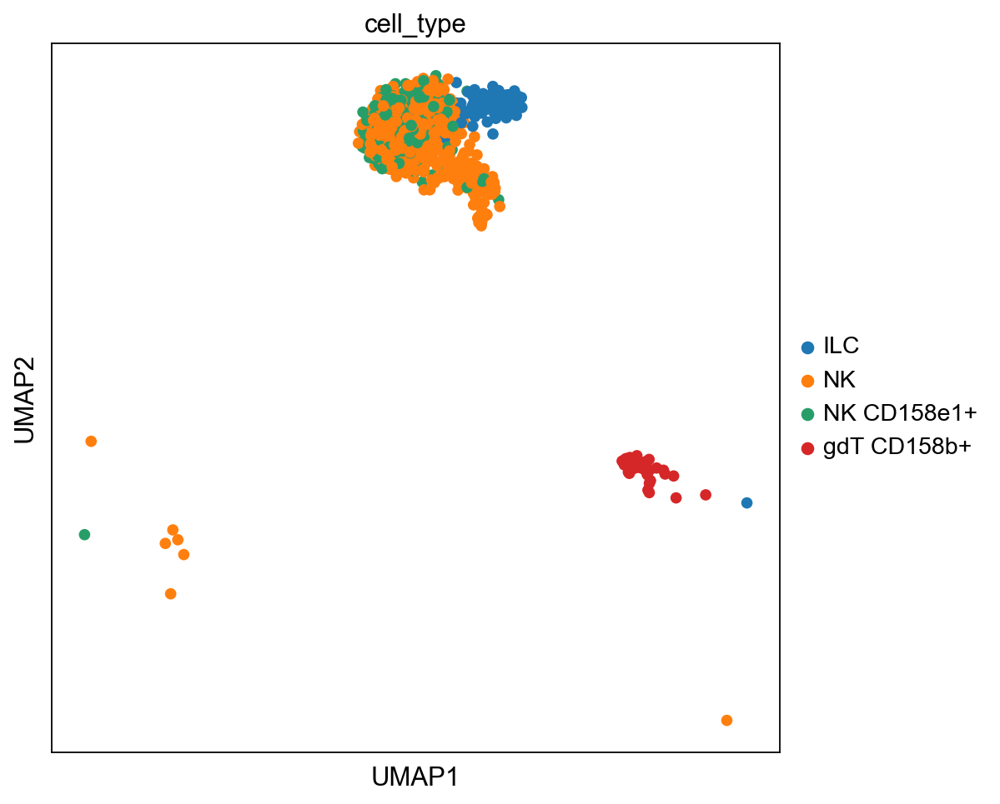

Immature markers, upper protein, below corresponding RNA


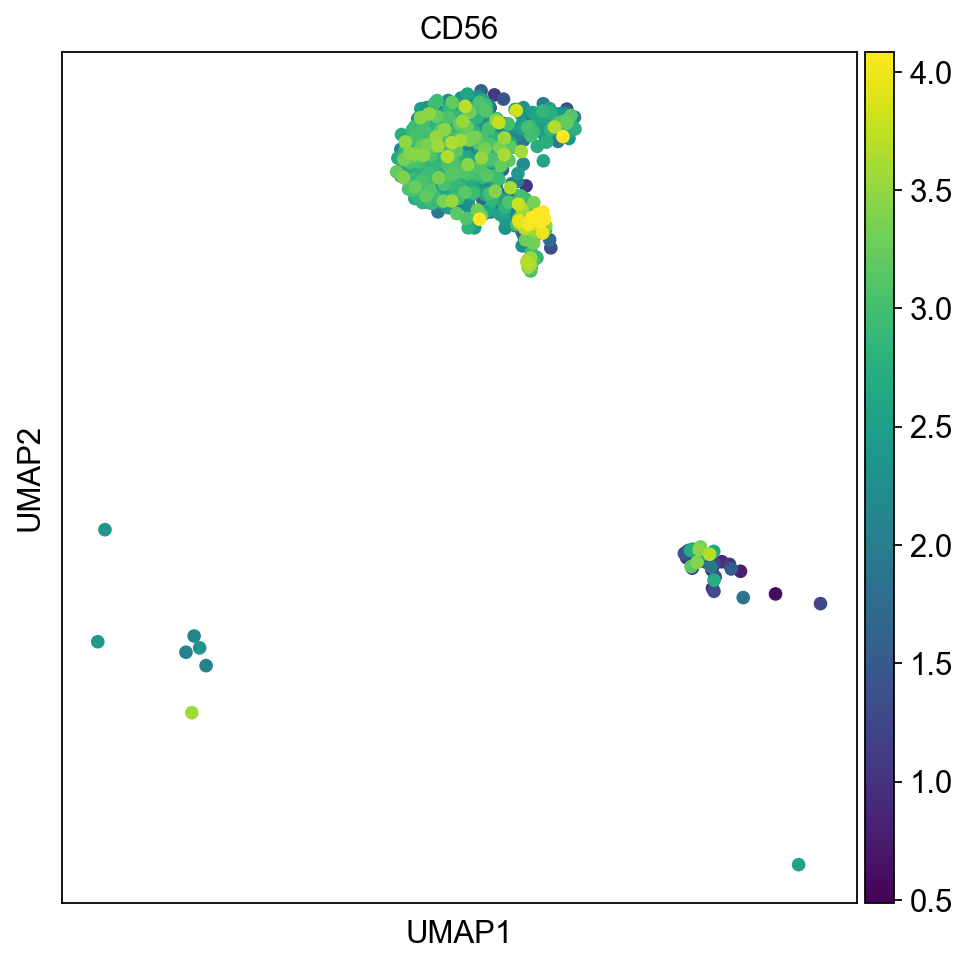

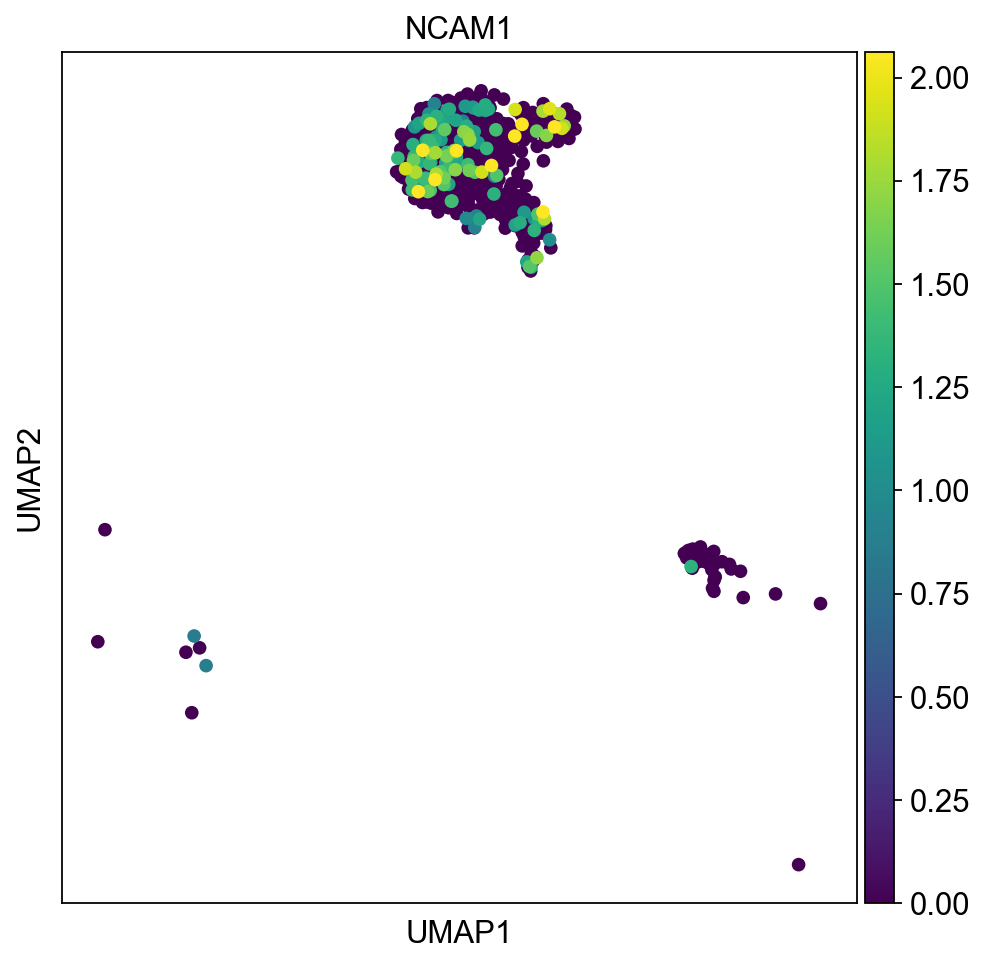

Mature markers, upper protein, below corresponding RNA


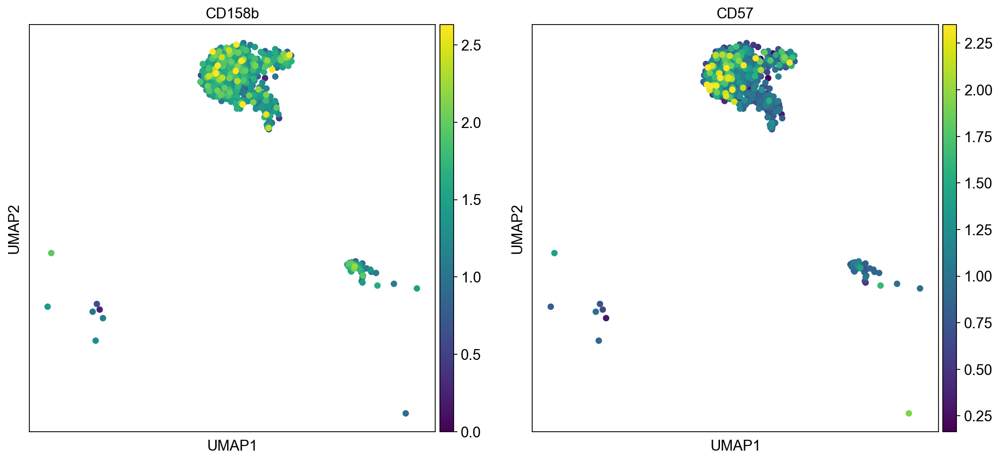

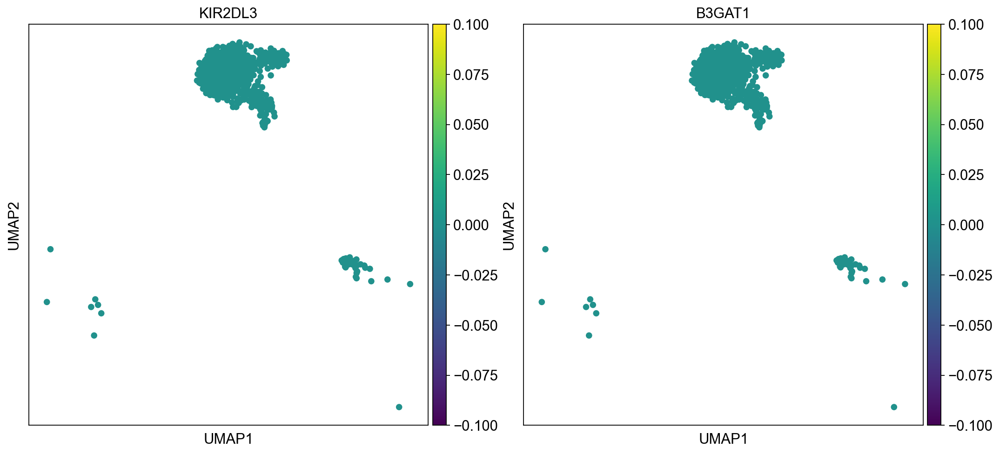

In [19]:
#selected cell types

sc.set_figure_params(figsize=(7, 7))
sc.pl.umap(sample_nk, color = ['cell_type'], color_map = 'viridis')

#NK immature

print("Immature markers, upper protein, below corresponding RNA")

sc.set_figure_params(figsize=(7, 7))
sc.pl.umap(sample_nk, color = nk_immature_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(sample_nk, color = nk_immature_pfef_rna, vmax="p99", color_map = 'viridis')

#NK mature (adaptive)

print("Mature markers, upper protein, below corresponding RNA")

sc.pl.umap(sample_nk, color = nk56dim_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(sample_nk, color = nk56dim_pfef_rna, vmax="p99", color_map = 'viridis')


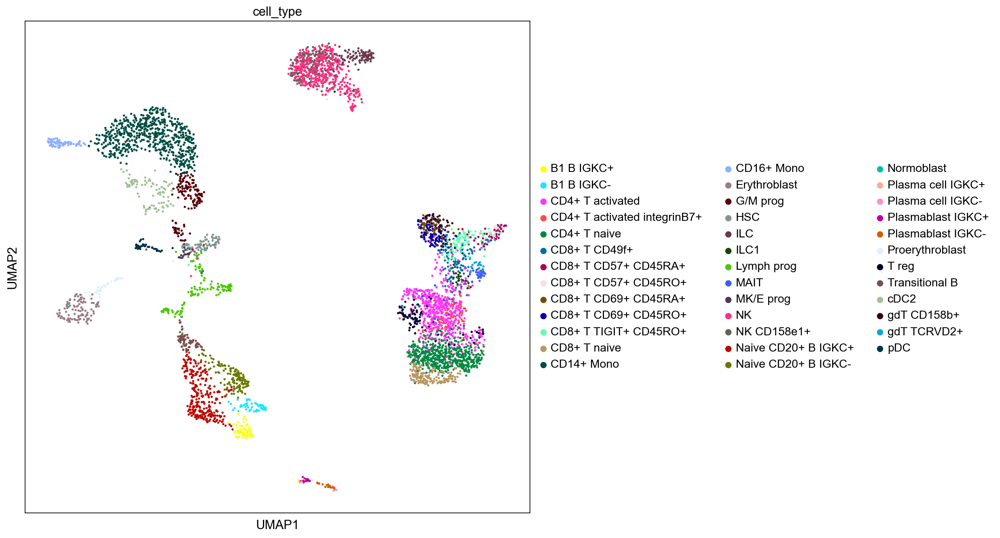

Immature markers, upper protein, below corresponding RNA


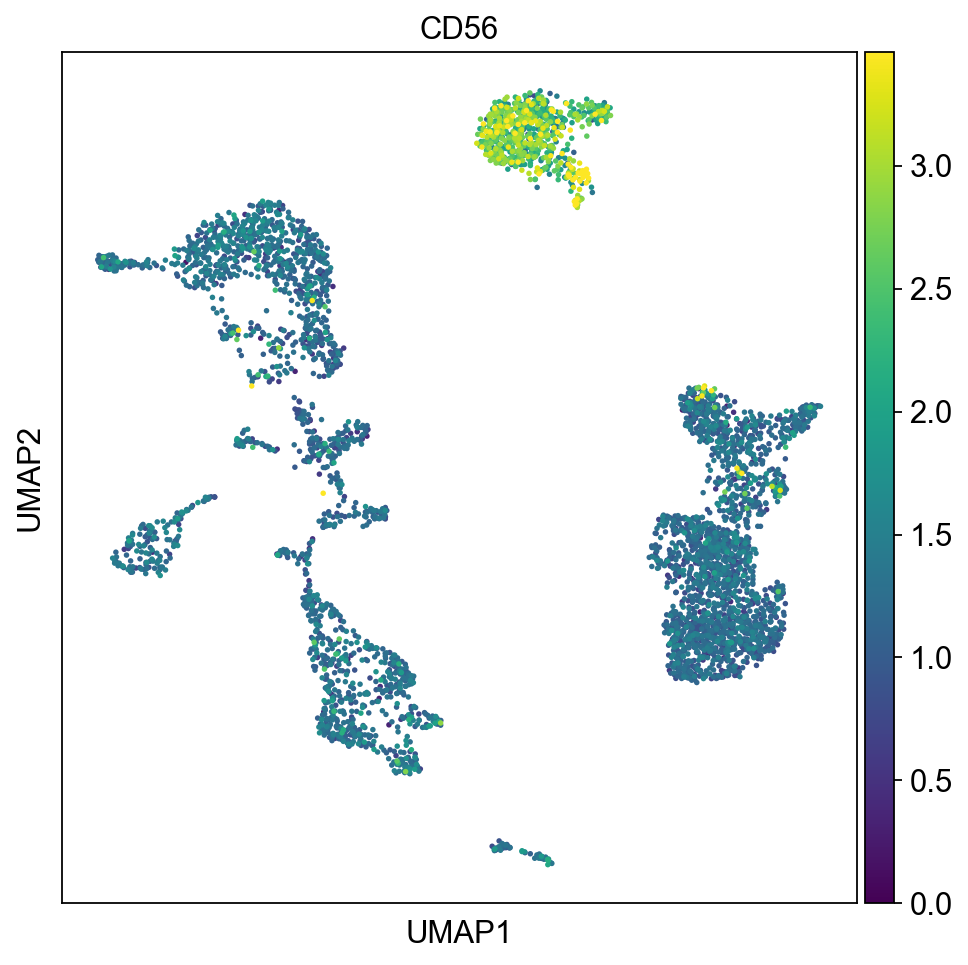

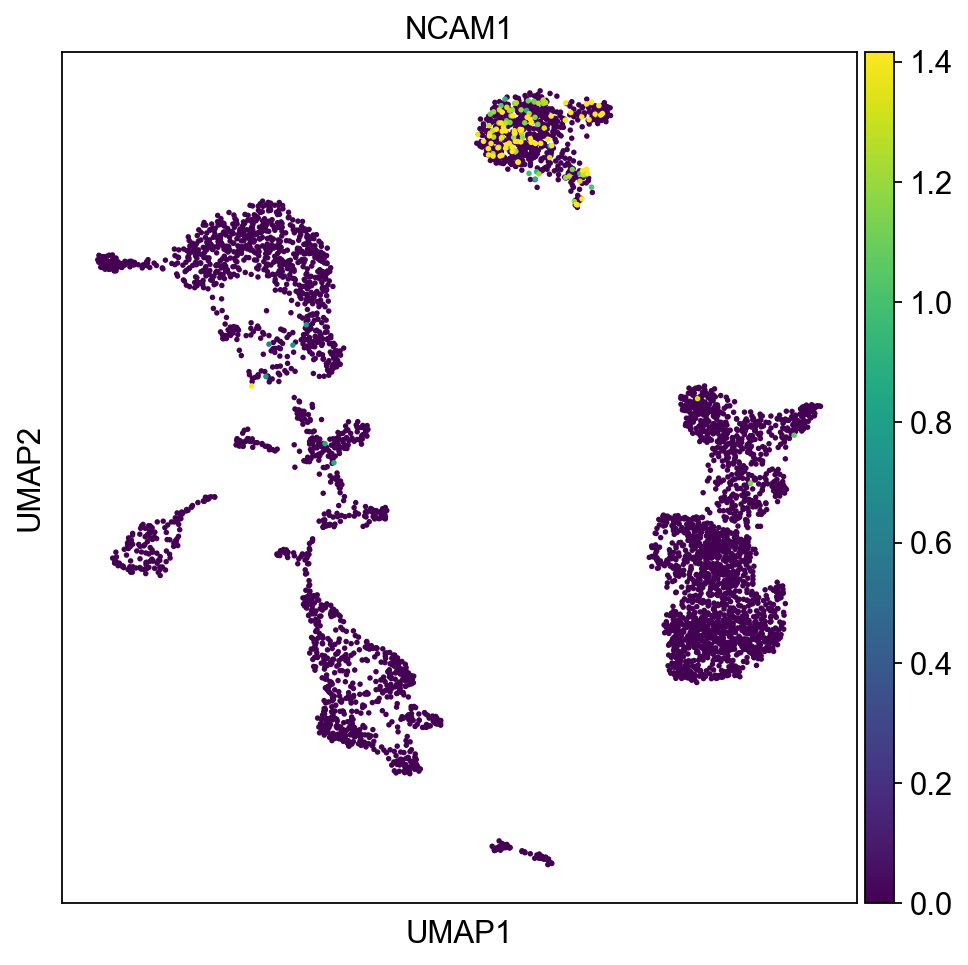

Mature markers, upper protein, below corresponding RNA


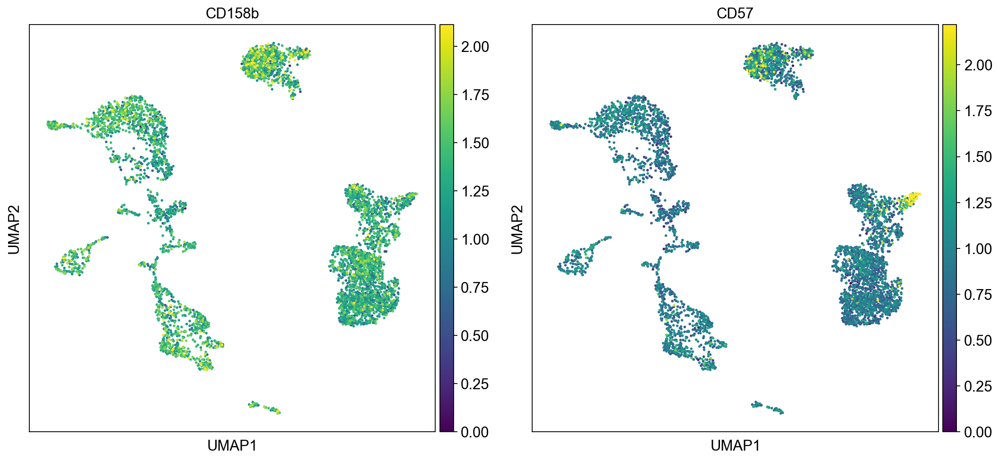

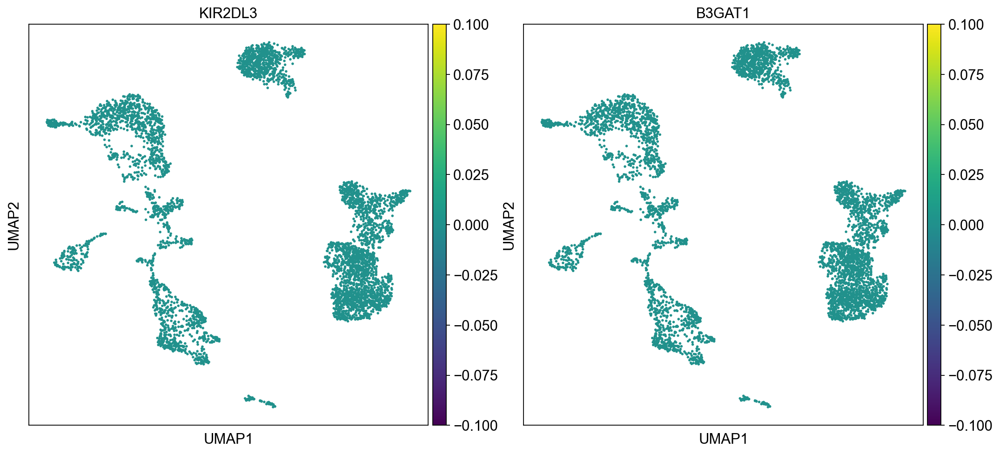

In [20]:
#all cell types

sc.set_figure_params(figsize=(10, 10))
sc.pl.umap(eg, color = ['cell_type'], color_map = 'viridis')

#NK immature

print("Immature markers, upper protein, below corresponding RNA")

sc.set_figure_params(figsize=(7, 7))
sc.pl.umap(eg, color = nk_immature_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(eg, color = nk_immature_pfef_rna, vmax="p99", color_map = 'viridis')

#NK mature (adaptive)

print("Mature markers, upper protein, below corresponding RNA")

sc.pl.umap(eg, color = nk56dim_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(eg, color = nk56dim_pfef_rna, vmax="p99", color_map = 'viridis')

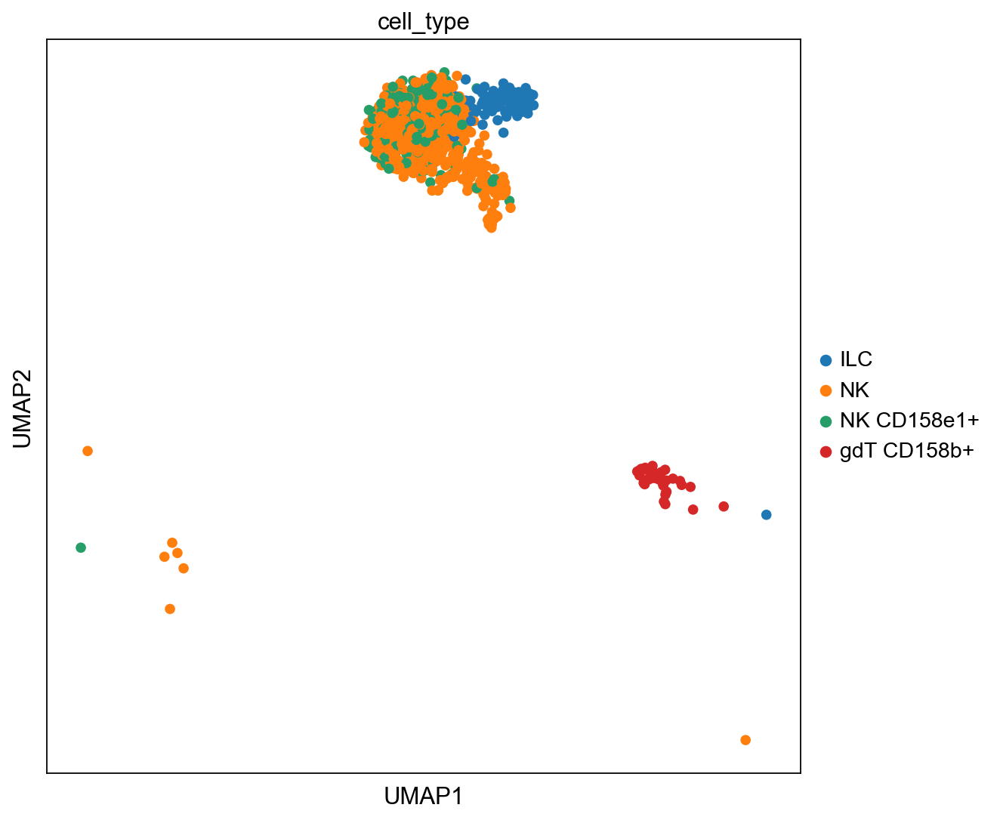

Cluster 1, upper protein, below corresponding RNA, most immature CD56bright


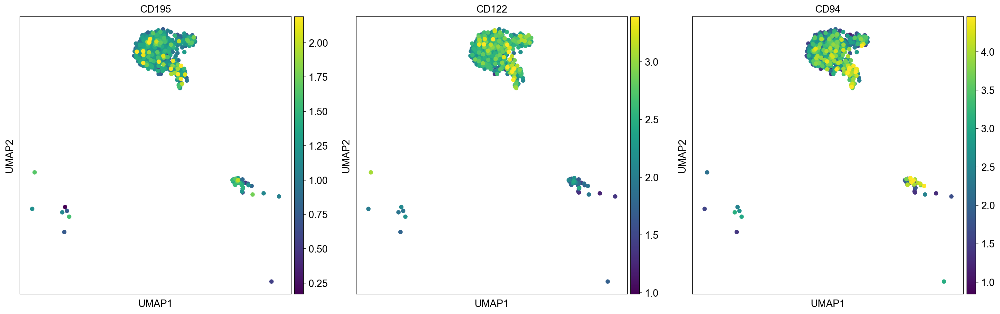

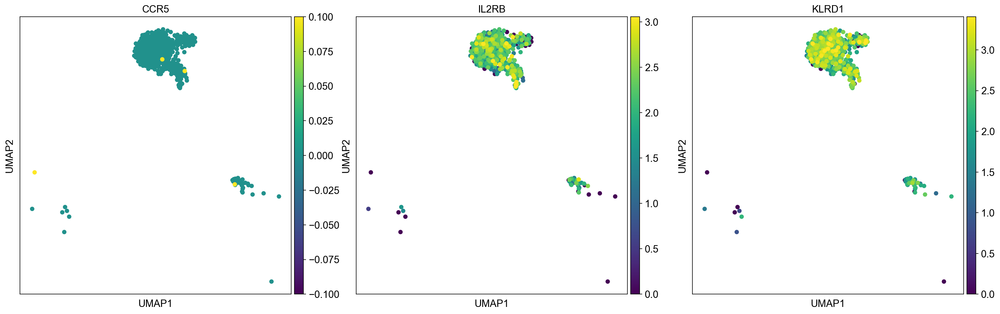

Cluster 2, upper protein, below corresponding RNA


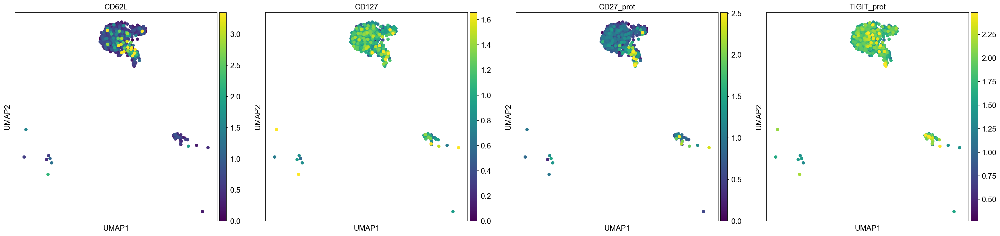

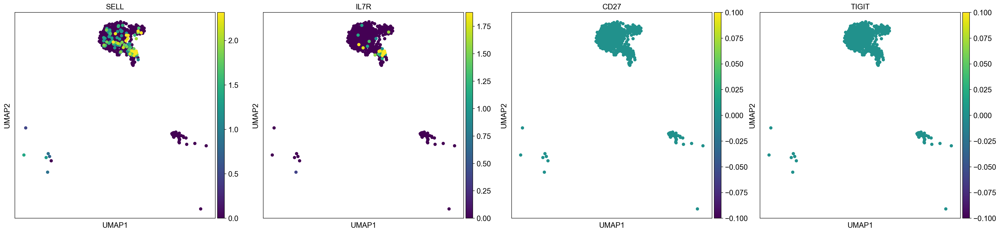

Cluster 3, upper protein, below corresponding RNA, CD56dim


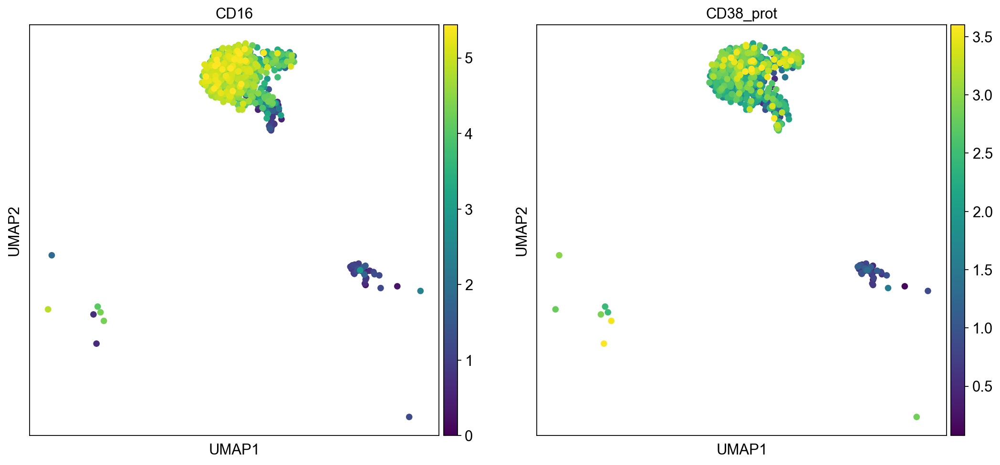

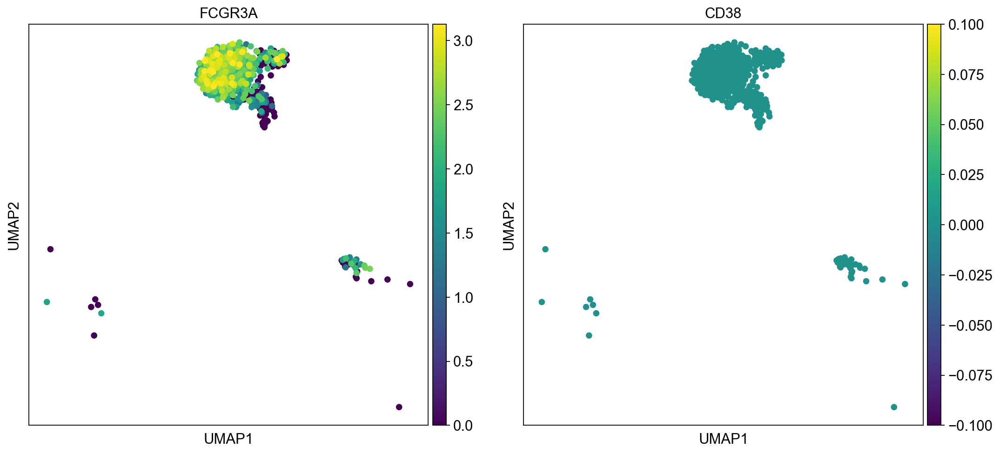

In [21]:
sc.set_figure_params(figsize=(8, 8))
sc.pl.umap(sample_nk, color = ['cell_type'], color_map = 'viridis')

#Clusters 1-3 by Pfef

sc.set_figure_params(figsize=(7, 7))

#Cluster 1 (most immature, CD56bright)

print("Cluster 1, upper protein, below corresponding RNA, most immature CD56bright")
sc.pl.umap(sample_nk, color = c1_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(sample_nk, color = c1_pfef_rna, vmax="p99", color_map = 'viridis')

#Cluster 2 (CD56bright)
print("Cluster 2, upper protein, below corresponding RNA")

sc.pl.umap(sample_nk, color = c2_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(sample_nk, color = c2_pfef_rna, vmax="p99", color_map = 'viridis')

#Cluster 3 (CD56dim)

print("Cluster 3, upper protein, below corresponding RNA, CD56dim")
sc.pl.umap(sample_nk, color = c3_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(sample_nk, color = c3_pfef_rna, vmax="p99", color_map = 'viridis')

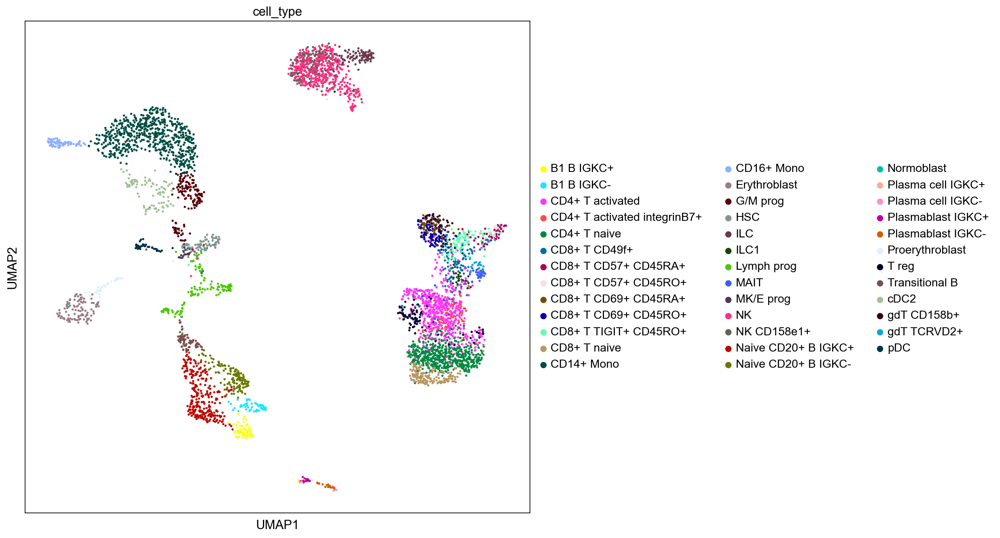

Cluster 1, upper protein, below corresponding RNA, most immature CD56bright


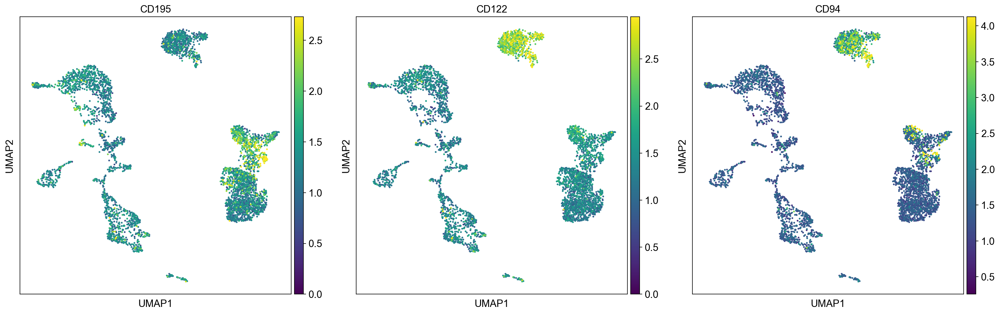

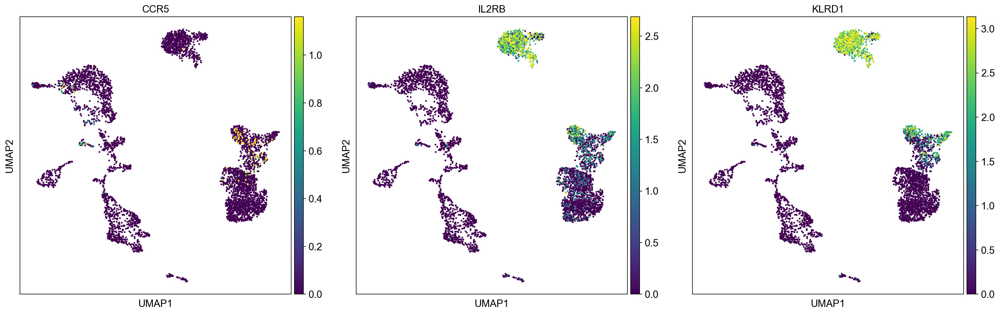

Cluster 2, upper protein, below corresponding RNA


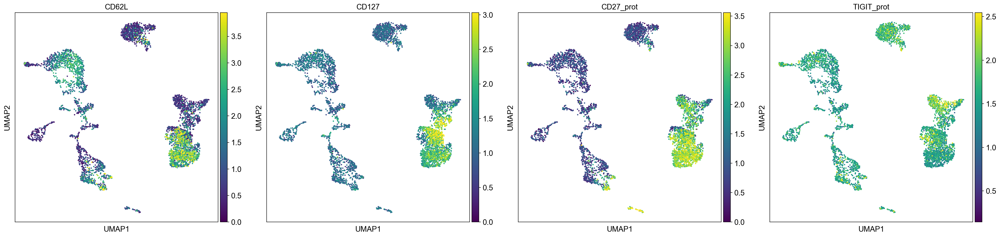

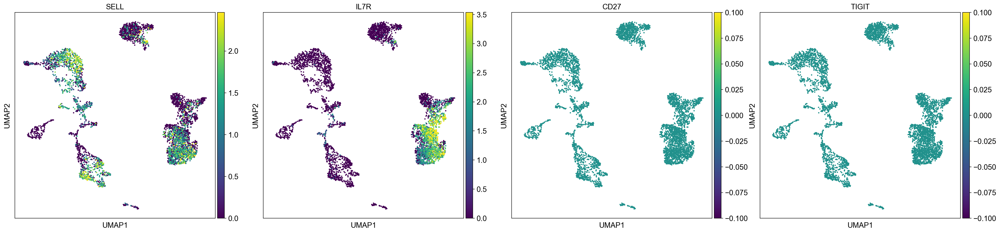

Cluster 3, upper protein, below corresponding RNA, CD56dim


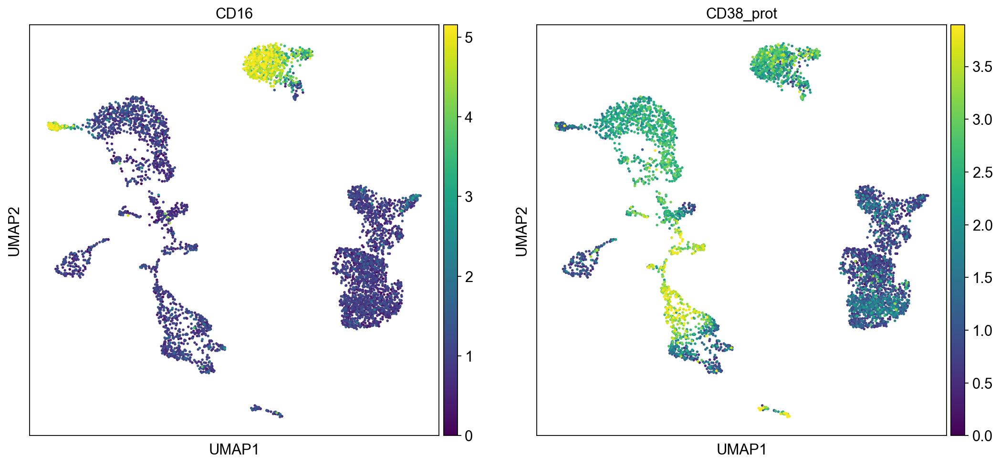

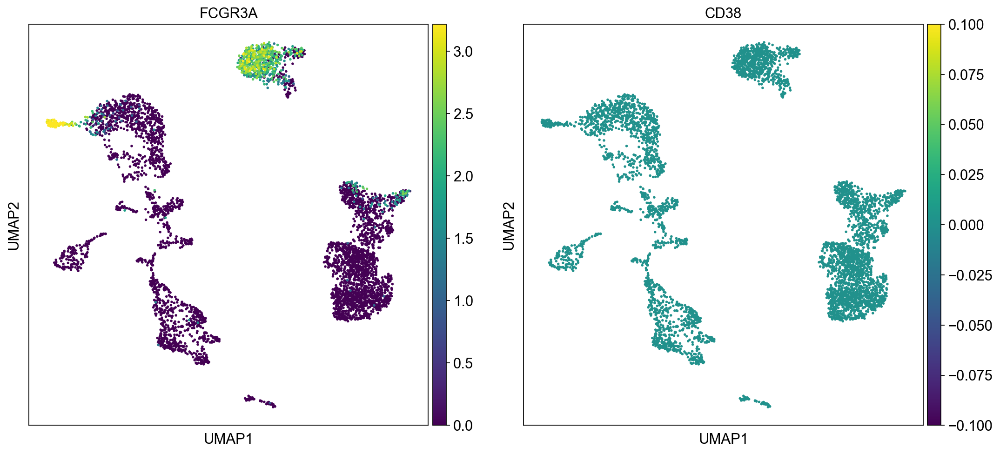

In [22]:
#All cell types

sc.set_figure_params(figsize=(10, 10))
sc.pl.umap(eg, color = ['cell_type'], color_map = 'viridis')

#Clusters 1-3 by Pfef

sc.set_figure_params(figsize=(7, 7))

#Cluster 1 (most immature, CD56bright)

print("Cluster 1, upper protein, below corresponding RNA, most immature CD56bright")
sc.pl.umap(eg, color = c1_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(eg, color = c1_pfef_rna, vmax="p99", color_map = 'viridis')

#Cluster 2 (CD56bright)
print("Cluster 2, upper protein, below corresponding RNA")

sc.pl.umap(eg, color = c2_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(eg, color = c2_pfef_rna, vmax="p99", color_map = 'viridis')

#Cluster 3 (CD56dim)

print("Cluster 3, upper protein, below corresponding RNA, CD56dim")
sc.pl.umap(eg, color = c3_pfef, vmax="p99", color_map = 'viridis')
    
sc.pl.umap(eg, color = c3_pfef_rna, vmax="p99", color_map = 'viridis')

- Cluster 1 and 2 are immature VD56 bright populations. CD94, CD62L (and corresponding RNA) CD27 signals come clearly from immature population (but not very strong). 
- CD16 (and corresponding RNA) useful to distinguish mature CD56 dim population

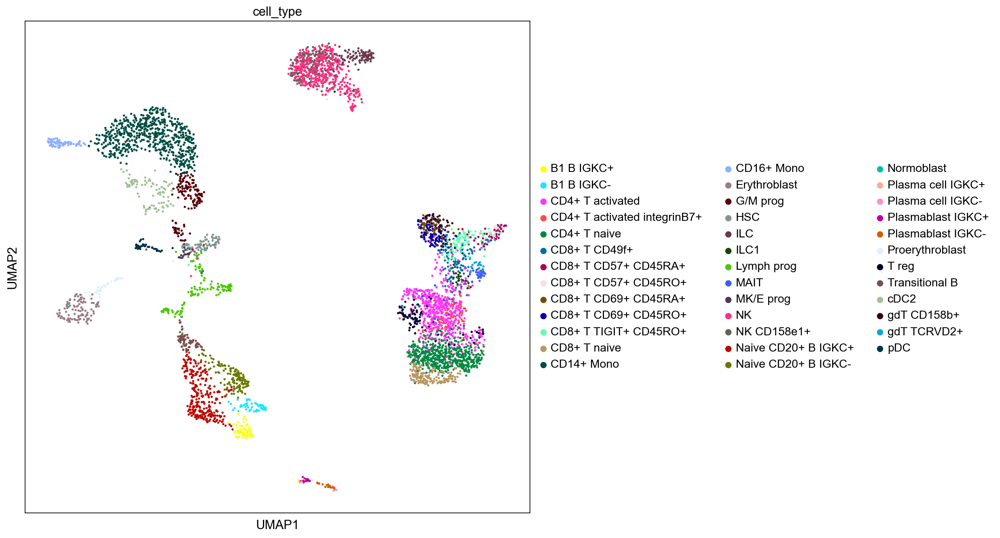

Cluster 1, CD56bright


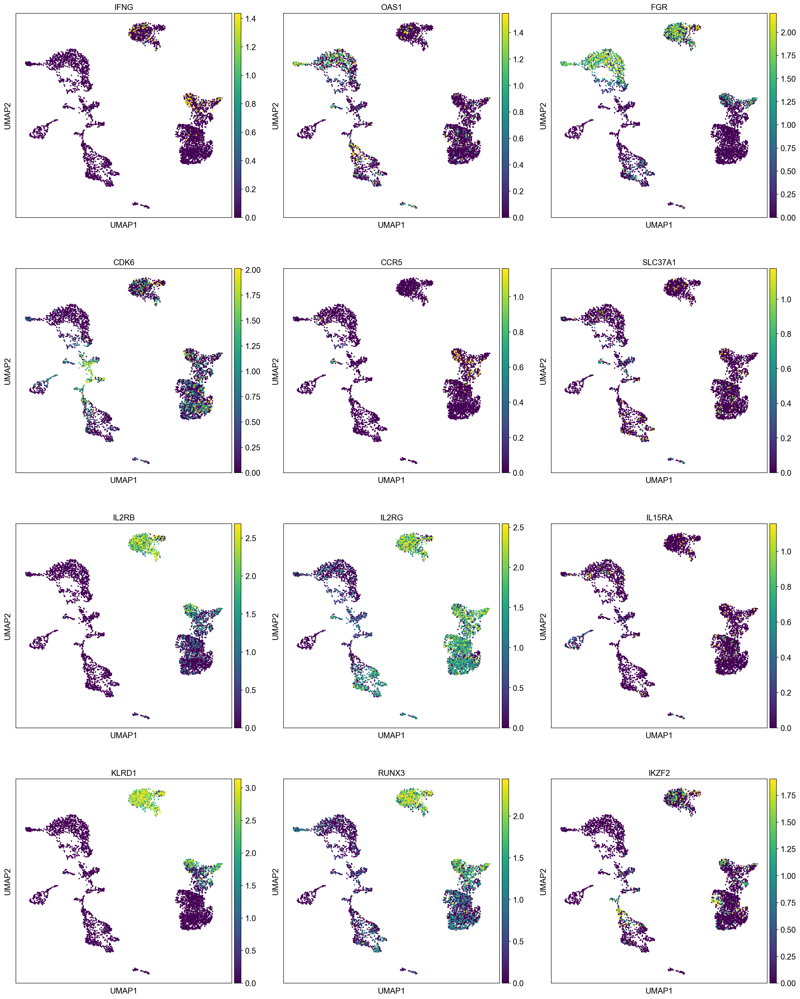

Cluster 2, CD56bright


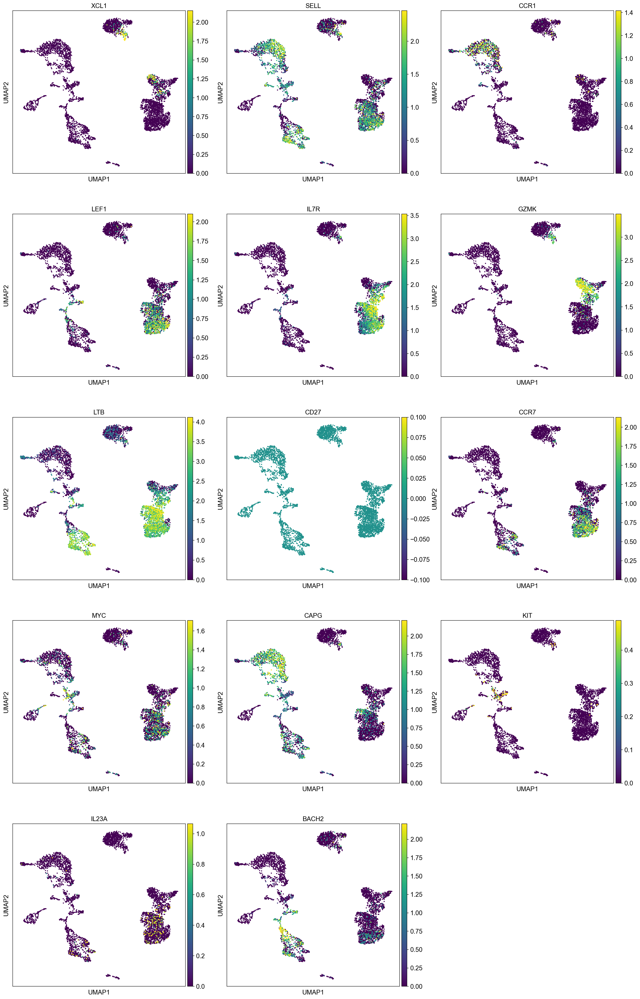

Cluster 3, CD56dim


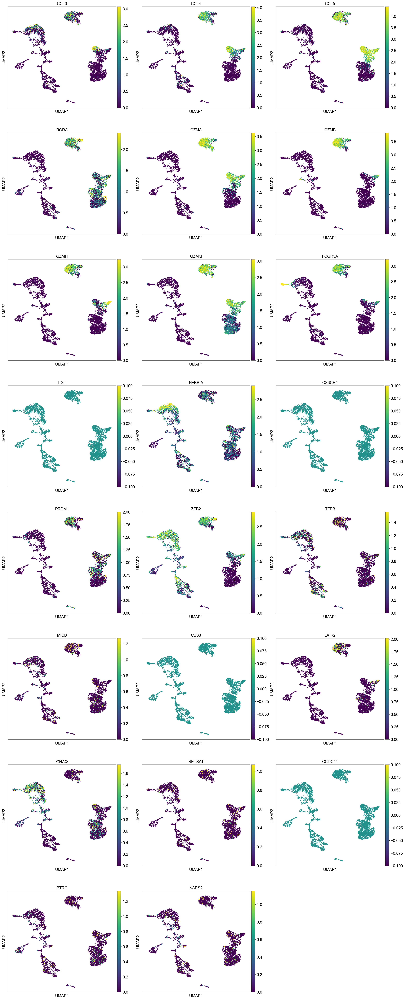

In [23]:
# Only RNA markers

clust1 = ['IFNG', 'OAS1', 'FGR', 'CDK6', 'CCR5', 'SLC37A1', 'IL2RB', 'IL2RG', 'IL15RA', 'KLRD1', 'RUNX3', 'IKZF2']
clust2 = ['XCL1', 'SELL', 'CCR1', 'LEF1', 'IL7R', 'GZMK', 'LTB', 'CD27', 'CCR7', 'MYC', 'CAPG', 'KIT', 'IL23A', 'BACH2']
clust3 = ['CCL3', 'CCL4', 'CCL5', 'RORA', 'GZMA', 'GZMB', 'GZMH', 'GZMM','FCGR3A', 'TIGIT', 'NFKBIA', 'CX3CR1', 'PRDM1', 'ZEB2', 'TFEB', 'MICB', 'CD38', 'LAIR2', 'GNAQ', 'RETSAT', 'CCDC41', 'BTRC', 'NARS2'] 


#All cell types

sc.set_figure_params(figsize=(10, 10))
sc.pl.umap(eg, color = ['cell_type'], color_map = 'viridis')

#Clusters 1-3 by Pfef

sc.set_figure_params(figsize=(7, 7))

#Cluster 1 (most immature, CD56bright)

print("Cluster 1, CD56bright")
sc.pl.umap(eg, color = clust1, vmax="p99", color_map = 'viridis', ncols = 3)

print("Cluster 2, CD56bright")
sc.pl.umap(eg, color = clust2, vmax="p99", color_map = 'viridis', ncols = 3)

print("Cluster 3, CD56dim")
sc.pl.umap(eg, color = clust3, vmax="p99", color_map = 'viridis', ncols = 3)


- Potential immature (CD56bright) markers: XCL1, GZMK
- Potential mature (CD56dim) markers: GZMB, GZMH, FCGR3A

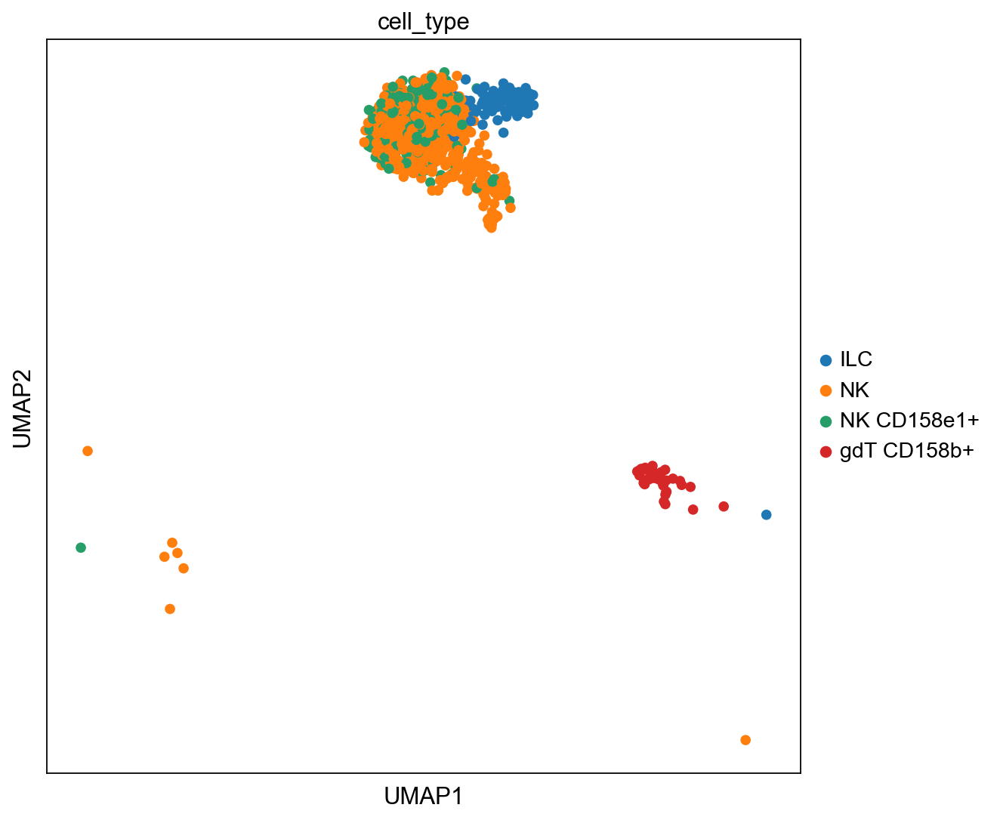

Transition


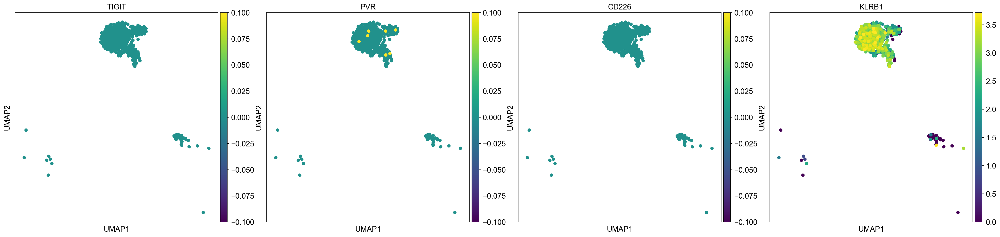

Pseudotime


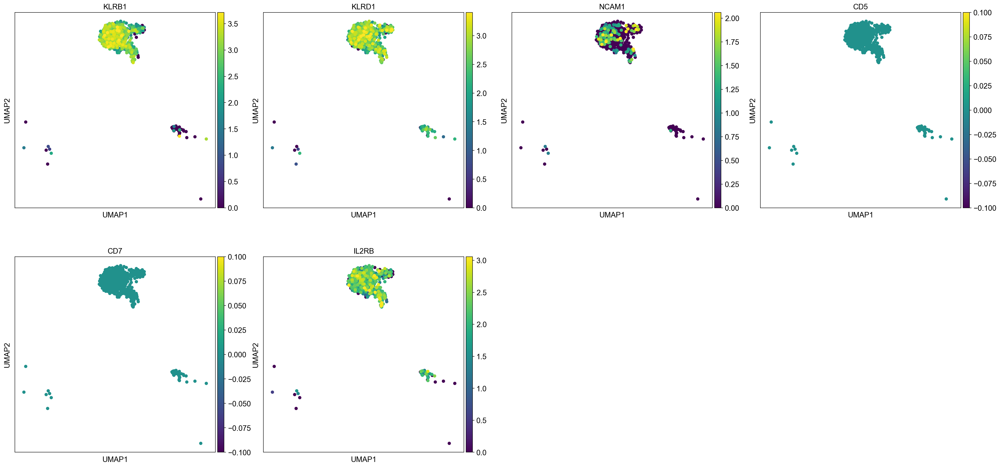

In [24]:
nk_transition_rna= ['TIGIT', 'PVR', 'CD226', 'KLRB1']
pseudotime_rna= ['KLRB1', 'KLRD1', 'NCAM1', 'CD5', 'CD7', 'IL2RB']


sc.set_figure_params(figsize=(8, 8))
sc.pl.umap(sample_nk, color = ['cell_type'], color_map = 'viridis')

#transition from CD56bright to CD56dim

sc.set_figure_params(figsize=(7, 7))

print("Transition")

sc.pl.umap(sample_nk, color = nk_transition_rna, vmax="p99", color_map = 'viridis')

print('Pseudotime')
    
sc.pl.umap(sample_nk, color = pseudotime_rna, vmax="p99", color_map = 'viridis')
